## NeurIPS true and null demo runs

**Purpose:** Display predictions for example train-test split

**Associated Figures:** Fig. 2

**Author:** Alexander Ratzan    
**Project:** Predicting Functional Brain Connectivity with Context-Aware Deep Neural Networks (NeurIPS 2025)

### Imports

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from env.imports import *

  import numpy.matlib as npm

  autumn = cm.get_cmap('autumn', 256)

  winter = cm.get_cmap('winter_r', 256)



In [3]:
import importlib
import data

import models
import sim.sim
import sim.sim_utils
from sim.sim_utils import bytes2human, print_system_usage
from sim.sim import Simulation
from sim.sim_run import single_sim_run

importlib.reload(sim.sim)
importlib.reload(sim.sim_run)
importlib.reload(models.train_val)
importlib.reload(data.data_utils)
importlib.reload(data.data_load)


Resorting genes by reference genome order
Resorting genes by reference genome order


<module 'data.data_load' from '/scratch/asr655/neuroinformatics/GeneEx2Conn/data/data_load.py'>

#### Check job specs

In [4]:
print_system_usage()

total = psutil.disk_usage('/').total
print(bytes2human(total))

CPU Usage: 14.4%
RAM Usage: 6.8%
Available RAM: 1.4T
Total RAM: 1.5T
52.4G


In [5]:
print(os.environ.get("CUDA_VISIBLE_DEVICES"))

# Check available GPUs
print(f"Available GPUs: {torch.cuda.device_count()}")

for i in range(torch.cuda.device_count()):
    print(f"GPU {i}: {torch.cuda.get_device_name(i)} - Memory Allocated: {torch.cuda.memory_allocated(i)/1024**3:.2f} GB")


0
Available GPUs: 1
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.00 GB


In [6]:
print("XGBoost version:", xgboost.__version__)
print("cupy version:", cp.__version__)

GPUtil.getAvailable()

# if a number is seen a GPU is availables
GPUtil.getGPUs()

DEVICE_ID_LIST = GPUtil.getFirstAvailable()
DEVICE_ID = DEVICE_ID_LIST[0] # grab first element from list
if DEVICE_ID != None: 
    print('GPU found', DEVICE_ID)
    use_gpu = True

    GPUtil.showUtilization()

XGBoost version: 2.0.3
cupy version: 13.1.0
GPU found 0
| ID | GPU | MEM |
------------------
|  0 |  0% |  0% |


In [7]:
torch.cuda.is_available()

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

## Example split demos <a id="sims"></a>

### Exponential decay

(note slightly higher values for this model as in Figure since updated to fit decay curve in single hemisphere instead of globally)

Resorting genes by reference genome order
Resorting genes by reference genome order
Number of components for 95% variance PCA: 27
Resorting genes by reference genome order
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
X_pca_full shape: (455, 455)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: euclidean, processing_type: None
features ['euclidean']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 2xj8473c
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/2xj8473c
Initialized sweep with ID: 2xj8473c
1
3
4
BEST CONFIG {'input_dim': 6, 'SA_inf': 0.0, 'SA_lambda': 10.0}
Optimized parameters: SA_inf=-0.023 SA_lambda=14.464
Running train evaluation...

=== TRAIN EVALUATION ===
Evaluating 341 regions, 115940 connections


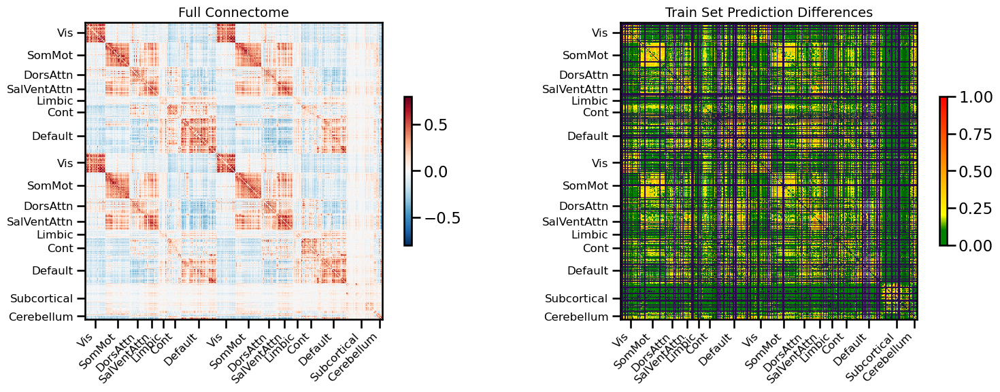

<Figure size 640x480 with 0 Axes>

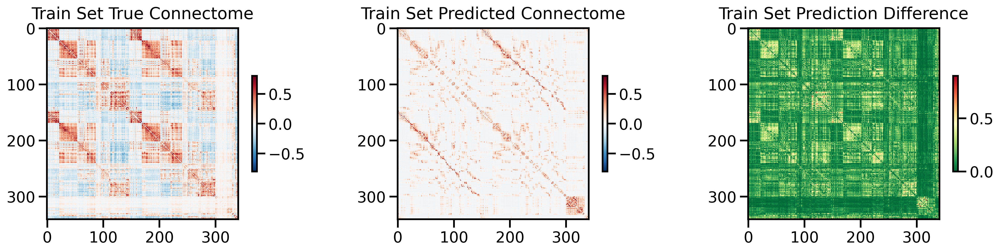

<Figure size 640x480 with 0 Axes>

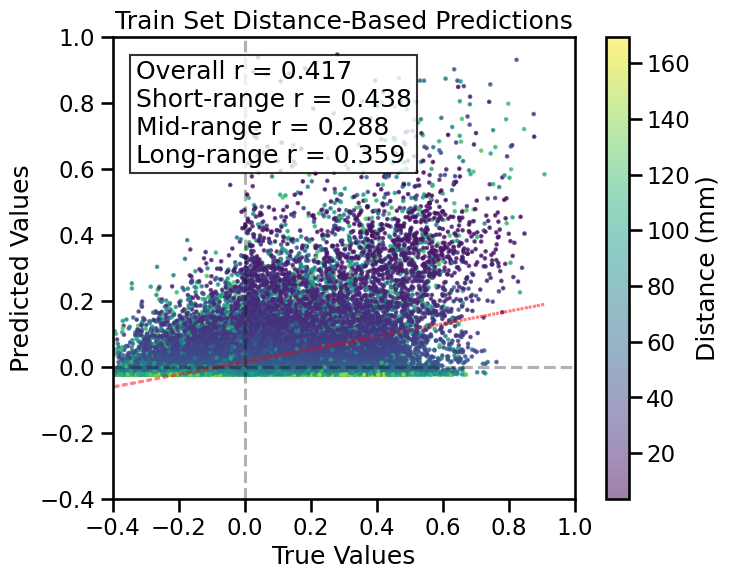

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 114 regions, 12882 connections


<Figure size 640x480 with 0 Axes>

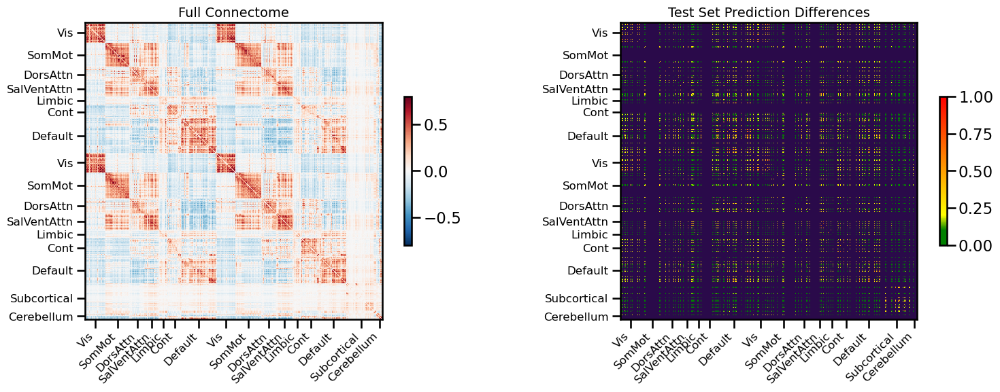

<Figure size 640x480 with 0 Axes>

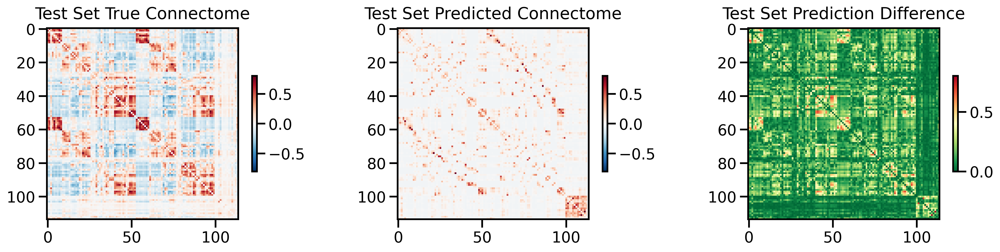

<Figure size 640x480 with 0 Axes>

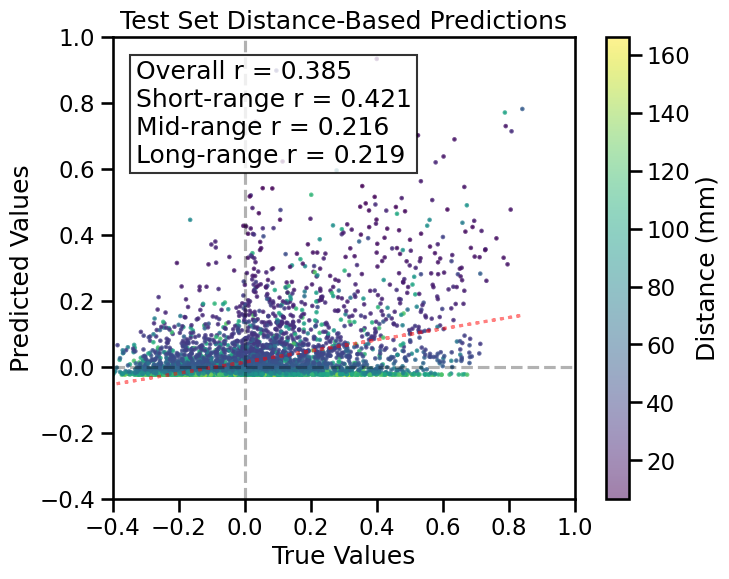

TRAIN METRICS
GLOBAL: mse=0.027557, mae=0.124294, r2=0.1720, pearson_r=0.4169, spearman_r=0.3227, geodesic_distance=24.9642
DISTANCE-BASED: short=0.4376, mid=0.2877, long=0.3592
HEMISPHERIC: left=0.4046, right=0.4368, inter=0.4219
CONNECTION STRENGTH: neg=0.0691, weak=0.2270, pos=0.4287
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.5194    0.4729
  Default       0.4486    0.4880
  SalVentAttn    0.4966    0.4826
  Limbic        0.7780    0.4959
  DorsAttn      0.5840    0.4870
  SomMot        0.5596    0.5224
  Vis           0.6040    0.5050
  Subcortical    0.1084    0.4498
  Cerebellum   -0.1481    0.4238

TEST METRICS
GLOBAL: mse=0.029953, mae=0.126156, r2=0.1453, pearson_r=0.3851, spearman_r=0.2982, geodesic_distance=15.6723
DISTANCE-BASED: short=0.4212, mid=0.2159, long=0.2191
HEMISPHERIC: left=0.3678, right=0.3489, inter=0.4164
CONNECTION STRENGTH: neg=0.1209, weak=0.2081, pos=0.3507
NETWORK CORRELATIONS:
  NETWORK      I

0

<Figure size 640x480 with 0 Axes>

In [16]:
single_sim_run(
              feature_type=[{'euclidean': None}],
              omit_subcortical=False,
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 5),
              track_wandb=False,
              skip_cv=True,
              model_type='exponential_decay',
              use_gpu=True, 
              null_model='none', 
              use_folds=[1])

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

### Correlated Gene Expression (CGE PCA)

Resorting genes by reference genome order
Resorting genes by reference genome order
Number of components for 95% variance PCA: 27
Resorting genes by reference genome order
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
X_pca_full shape: (455, 455)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome_PCA_95var, processing_type: None
features ['transcriptome_PCA_95var']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 4tt4hodn
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/4tt4hodn
Initialized sweep with ID: 4tt4hodn
1
3
4
BEST CONFIG {'input_dim': 54, 'scale_range': {'value': False}}
Running train evaluation...

=== TRAIN EVALUATION ===
Evaluating 341 regions, 115940 connections


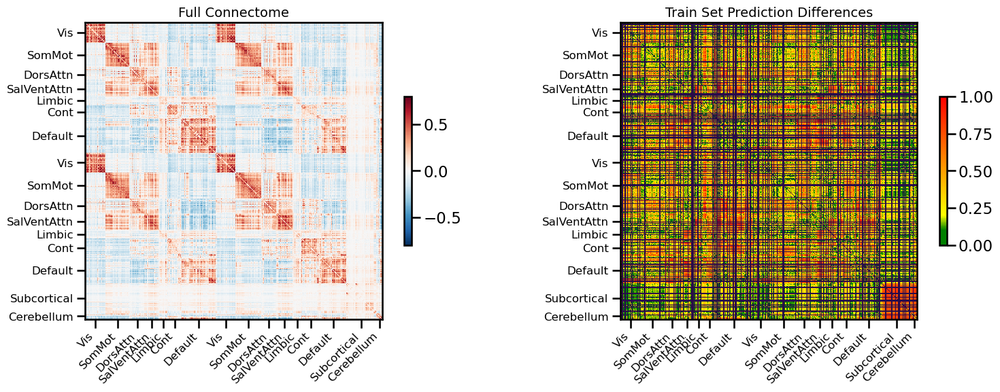

<Figure size 640x480 with 0 Axes>

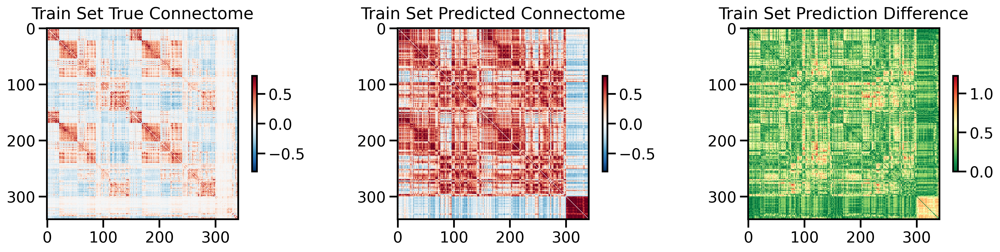

<Figure size 640x480 with 0 Axes>

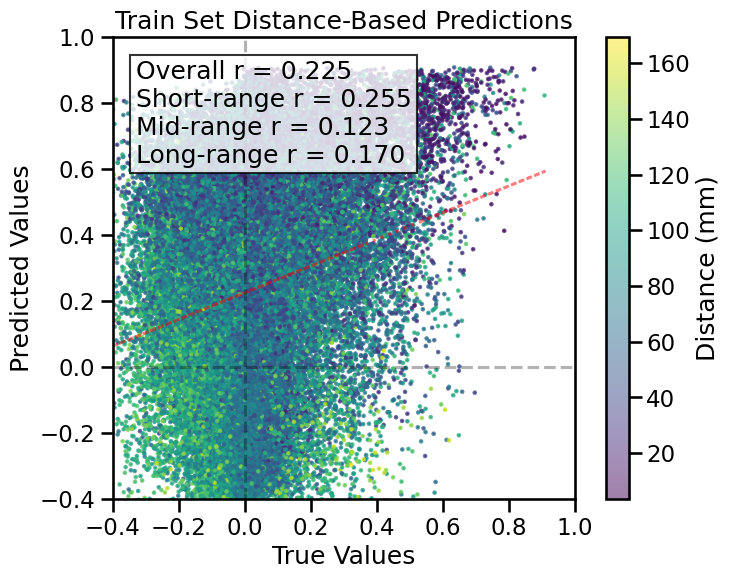

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 114 regions, 12882 connections


<Figure size 640x480 with 0 Axes>

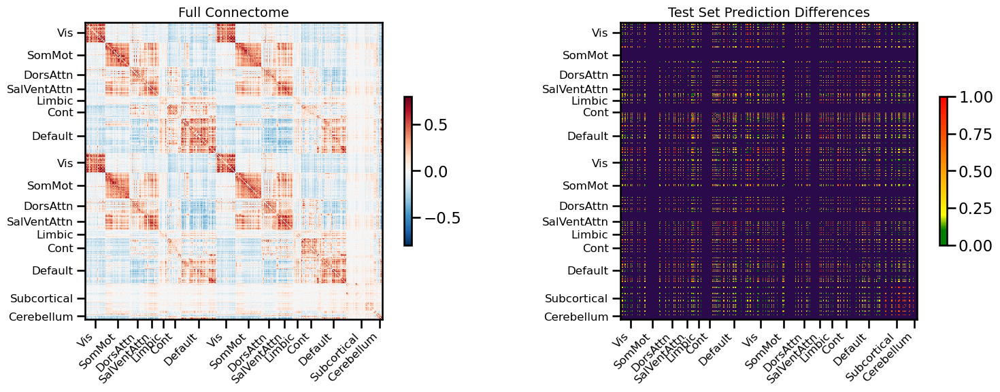

<Figure size 640x480 with 0 Axes>

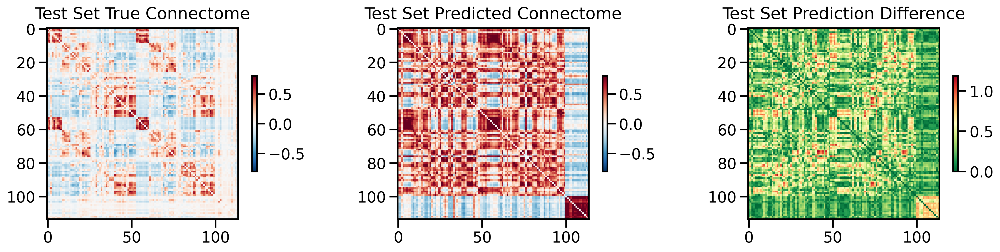

<Figure size 640x480 with 0 Axes>

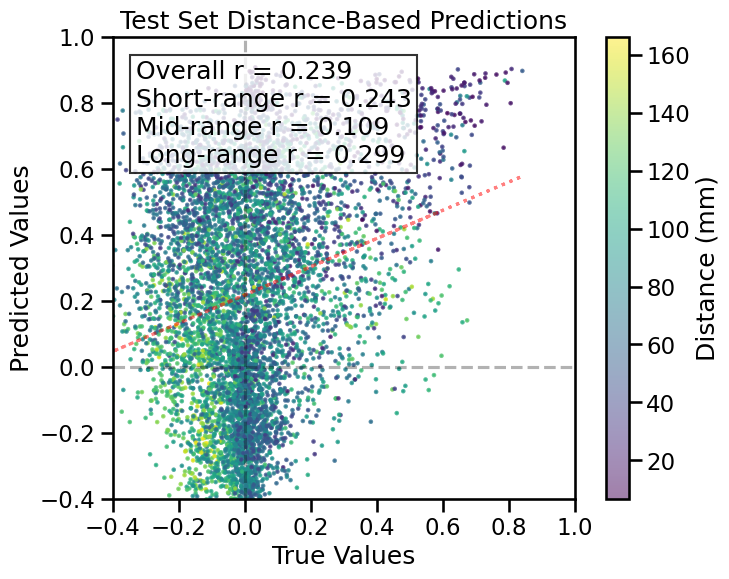

TRAIN METRICS
GLOBAL: mse=0.159593, mae=0.331231, r2=-3.7950, pearson_r=0.2250, spearman_r=0.1561, geodesic_distance=22.7063
DISTANCE-BASED: short=0.2549, mid=0.1233, long=0.1701
HEMISPHERIC: left=0.2459, right=0.2569, inter=0.1972
CONNECTION STRENGTH: neg=0.0303, weak=0.0670, pos=0.2786
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.2747    0.2613
  Default       0.2391    0.2662
  SalVentAttn    0.2953    0.2760
  Limbic        0.2894    0.2464
  DorsAttn      0.2156    0.2304
  SomMot        0.2982    0.2828
  Vis           0.4081    0.3160
  Subcortical    0.0565    0.2500
  Cerebellum    0.2340    0.2473

TEST METRICS
GLOBAL: mse=0.161458, mae=0.328401, r2=-3.6072, pearson_r=0.2389, spearman_r=0.1736, geodesic_distance=15.5130
DISTANCE-BASED: short=0.2430, mid=0.1089, long=0.2989
HEMISPHERIC: left=0.2414, right=0.2611, inter=0.2292
CONNECTION STRENGTH: neg=0.0711, weak=0.0804, pos=0.3820
NETWORK CORRELATIONS:
  NETWORK     

0

<Figure size 640x480 with 0 Axes>

In [13]:
single_sim_run(
              feature_type=[{'transcriptome_PCA_95var': None}],
              omit_subcortical=False,
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 5),
              track_wandb=False,
              skip_cv=True,
              model_type='cge',
              use_gpu=True, 
              null_model='none', 
              use_folds=[1])

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

Resorting genes by reference genome order
Spinning gene expression
Spin index for seed 42: 9
Mean error rank for spin index 9: 263.3333333333333
Resorting genes by reference genome order
Number of components for 95% variance PCA: 27
Spinning gene expression
Spin index for seed 42: 9
Mean error rank for spin index 9: 263.3333333333333
Resorting genes by reference genome order
Spinning gene expression
Spin index for seed 42: 9
Mean error rank for spin index 9: 263.3333333333333
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
X_pca_full shape: (455, 455)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome_PCA_95var, processing_type: None
features ['transcriptome_PCA_95var']
Feature matrix, X, generated..

wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: vqqchxzk
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/vqqchxzk
Initialized sweep with ID: vqqchxzk
1
3
4
BEST CONFIG {'input_dim': 54, 'scale_range': {'value': False}}
Running train evaluation...

=== TRAIN EVALUATION ===
Evaluating 341 regions, 115940 connections


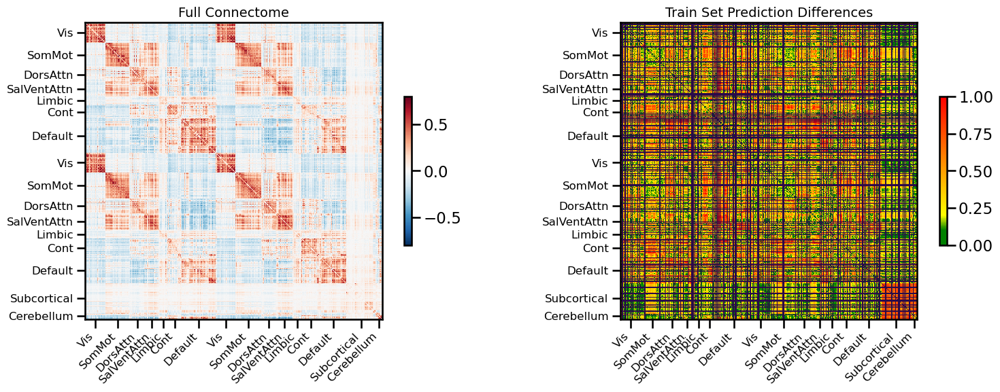

<Figure size 640x480 with 0 Axes>

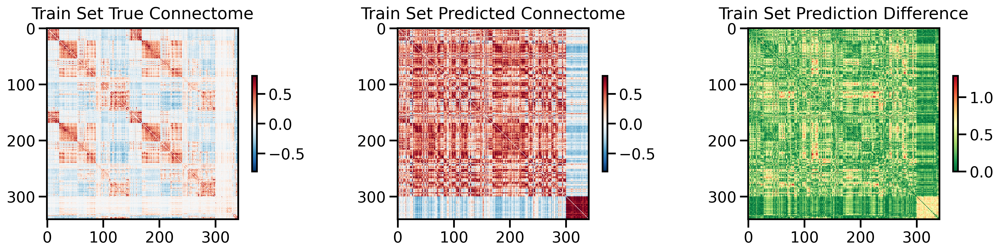

<Figure size 640x480 with 0 Axes>

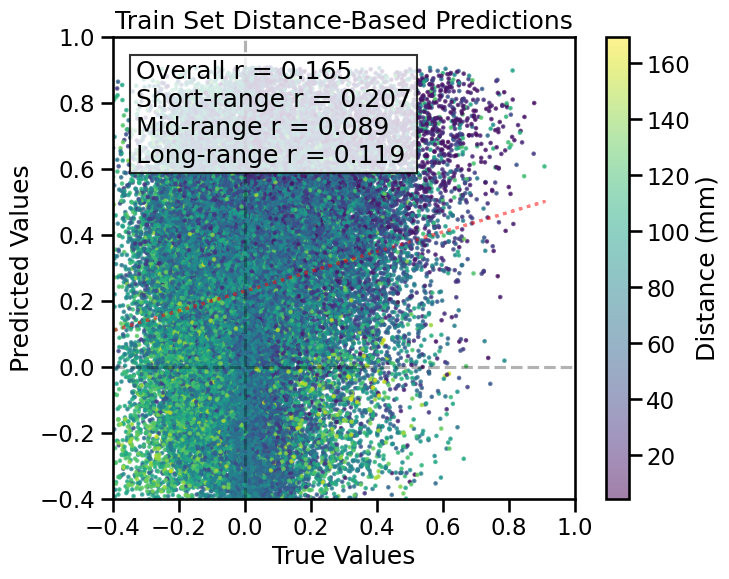

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 114 regions, 12882 connections


<Figure size 640x480 with 0 Axes>

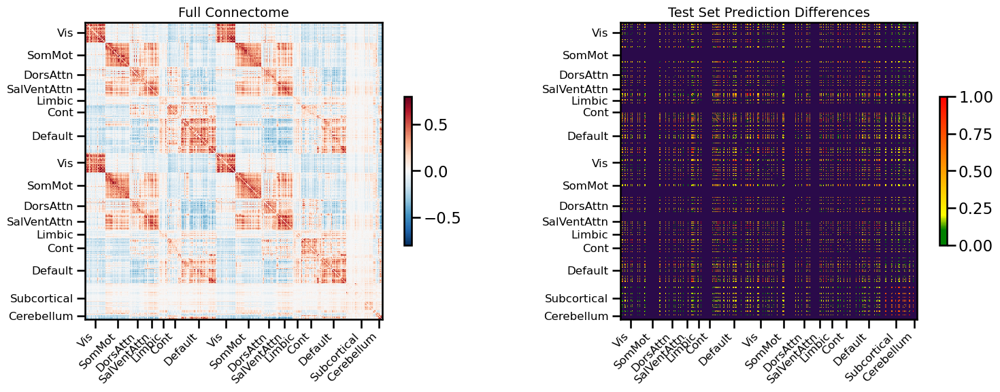

<Figure size 640x480 with 0 Axes>

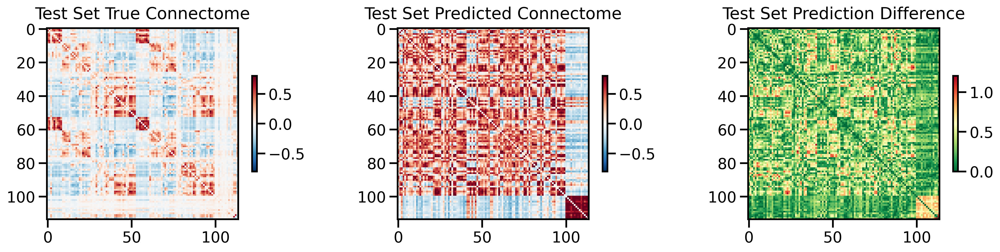

<Figure size 640x480 with 0 Axes>

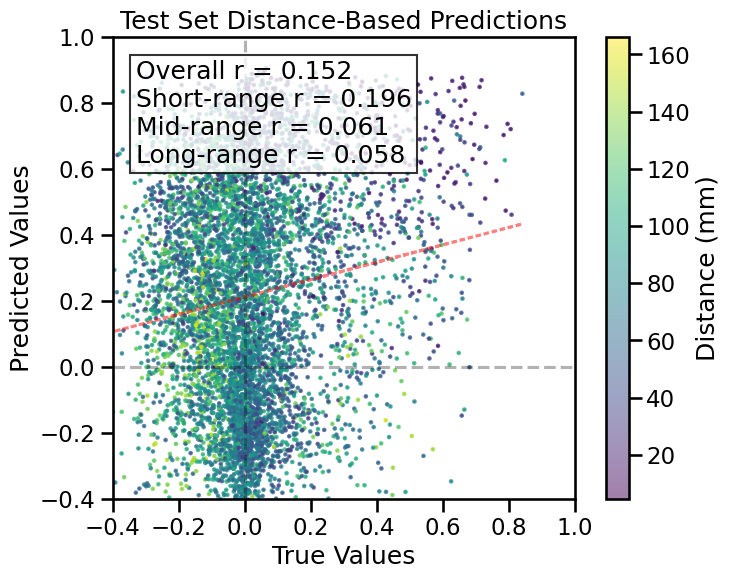

TRAIN METRICS
GLOBAL: mse=0.169147, mae=0.338003, r2=-4.0763, pearson_r=0.1655, spearman_r=0.1079, geodesic_distance=22.8751
DISTANCE-BASED: short=0.2074, mid=0.0886, long=0.1186
HEMISPHERIC: left=0.1636, right=0.1976, inter=0.1495
CONNECTION STRENGTH: neg=-0.0151, weak=0.0391, pos=0.2124
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.0760    0.1389
  Default       0.2258    0.2044
  SalVentAttn    0.2462    0.1878
  Limbic        0.2746    0.1823
  DorsAttn      0.2735    0.1830
  SomMot        0.2732    0.2367
  Vis           0.2102    0.1909
  Subcortical   -0.1806    0.1931
  Cerebellum   -0.2486    0.2007

TEST METRICS
GLOBAL: mse=0.165077, mae=0.333132, r2=-3.5831, pearson_r=0.1521, spearman_r=0.0948, geodesic_distance=15.1444
DISTANCE-BASED: short=0.1960, mid=0.0615, long=0.0577
HEMISPHERIC: left=0.1408, right=0.1528, inter=0.1594
CONNECTION STRENGTH: neg=0.1985, weak=0.0330, pos=0.2086
NETWORK CORRELATIONS:
  NETWORK    

0

<Figure size 640x480 with 0 Axes>

In [14]:
single_sim_run(
              feature_type=[{'transcriptome_PCA_95var': None}],
              omit_subcortical=False,
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 5),
              track_wandb=False,
              skip_cv=True,
              model_type='cge',
              use_gpu=True, 
              null_model='spin', 
              use_folds=[1])

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

### Bilinear Low-rank

Resorting genes by reference genome order
Resorting genes by reference genome order
Number of components for 95% variance PCA: 27
Resorting genes by reference genome order
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
X_pca_full shape: (455, 455)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 7jnflg03
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/7jnflg03
Initialized sweep with ID: 7jnflg03


  warnings.warn(



1
3
4
BEST CONFIG {'input_dim': 14760, 'activation': 'none', 'learning_rate': 0.0001, 'batch_size': 256, 'regularization': 'l2', 'lambda_reg': 0.001, 'shared_weights': True, 'reduced_dim': 10, 'epochs': 75}
Number of learnable parameters in Bilinear low rank model: 73800
  Linear layer 1: 73800 parameters
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.08 GB
Best val loss so far at epoch 1: 0.0327
Best val loss so far at epoch 2: 0.0298
Best val loss so far at epoch 3: 0.0287
Best val loss so far at epoch 4: 0.0270
Best val loss so far at epoch 5: 0.0262
Epoch 5/75, Train Loss: 0.0219, Val Loss: 0.0262, Time: 1.98s
Best val loss so far at epoch 6: 0.0253
Best val loss so far at epoch 7: 0.0251
Best val loss so far at epoch 8: 0.0248
Best val loss so far at epoch 9: 0.0246
Best val loss so far at epoch 10: 0.0246
Epoch 10/75, Train Loss: 0.0190, Val Loss: 0.0246, Time: 2.02s
Best val loss so far at epoch 11: 0.0244
Best val loss so far at epoch 12: 0.0244
Best val 

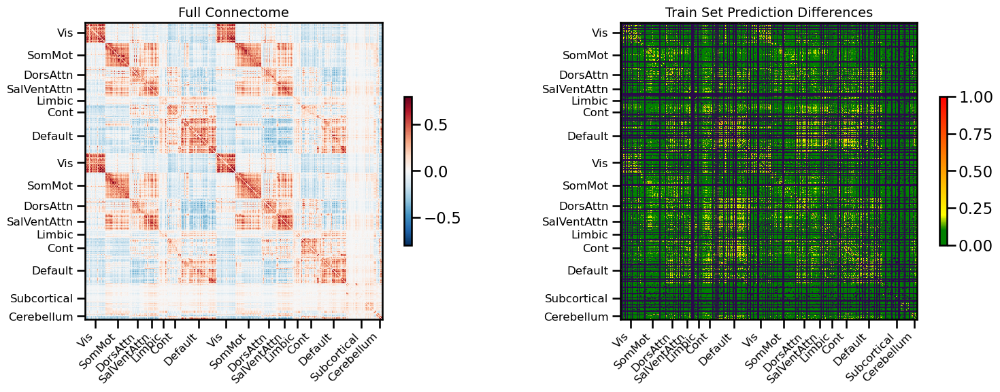

<Figure size 640x480 with 0 Axes>

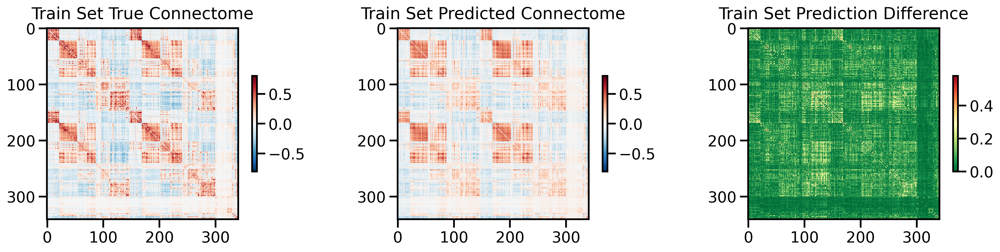

<Figure size 640x480 with 0 Axes>

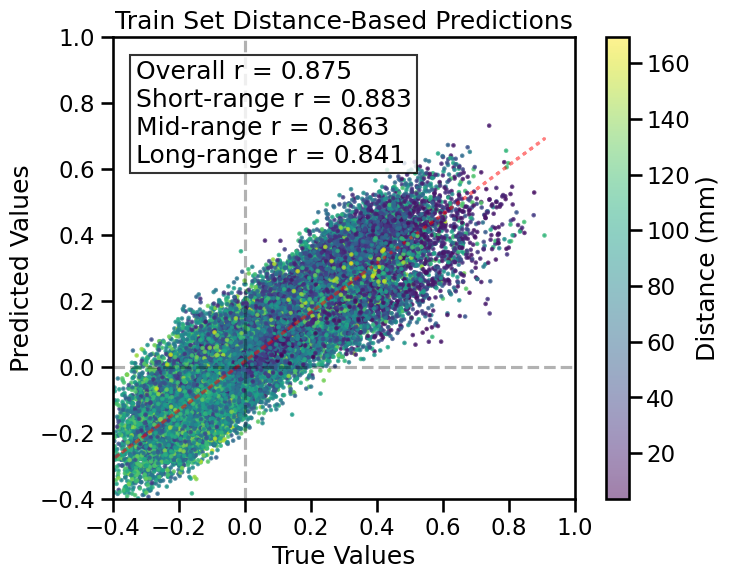

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 114 regions, 12882 connections


<Figure size 640x480 with 0 Axes>

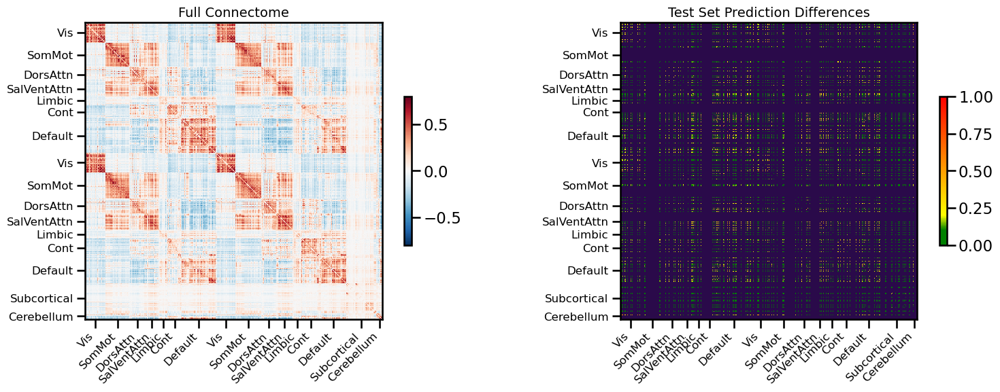

<Figure size 640x480 with 0 Axes>

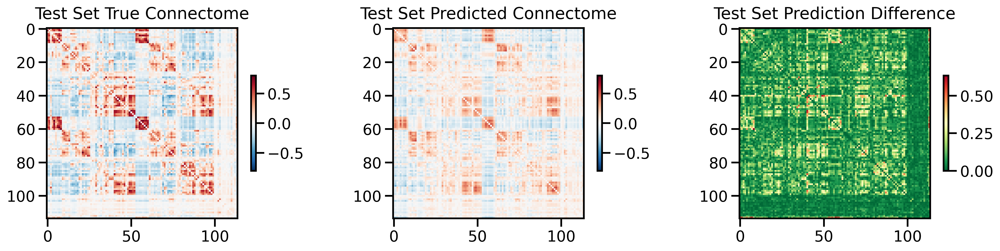

<Figure size 640x480 with 0 Axes>

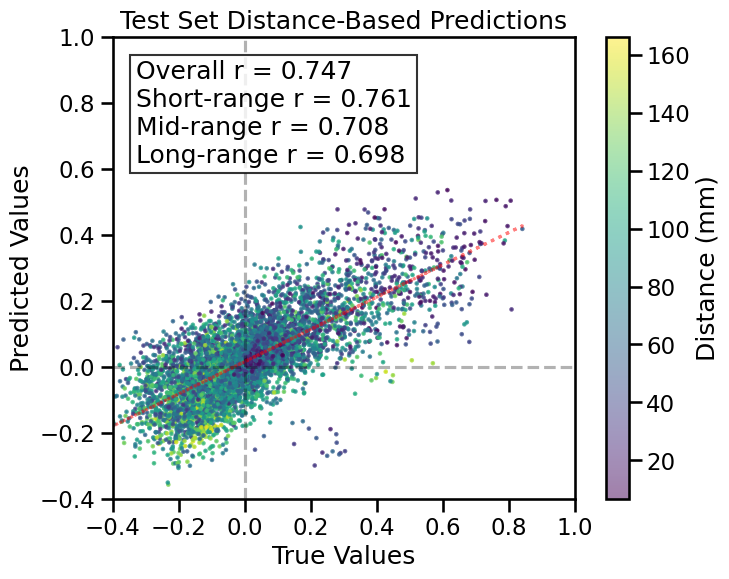

TRAIN METRICS
GLOBAL: mse=0.007966, mae=0.064609, r2=0.7607, pearson_r=0.8754, spearman_r=0.8649, geodesic_distance=18.3226
DISTANCE-BASED: short=0.8830, mid=0.8633, long=0.8409
HEMISPHERIC: left=0.8857, right=0.8822, inter=0.8713
CONNECTION STRENGTH: neg=0.1730, weak=0.8234, pos=0.3904
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9527    0.9127
  Default       0.8702    0.8915
  SalVentAttn    0.9419    0.9022
  Limbic        0.9174    0.9046
  DorsAttn      0.9373    0.9090
  SomMot        0.8893    0.9134
  Vis           0.8852    0.8836
  Subcortical    0.8286    0.8865
  Cerebellum    0.7731    0.8851

TEST METRICS
GLOBAL: mse=0.015874, mae=0.090651, r2=0.5470, pearson_r=0.7469, spearman_r=0.7272, geodesic_distance=11.9153
DISTANCE-BASED: short=0.7613, mid=0.7084, long=0.6984
HEMISPHERIC: left=0.7167, right=0.7997, inter=0.7430
CONNECTION STRENGTH: neg=-0.0122, weak=0.6471, pos=0.3884
NETWORK CORRELATIONS:
  NETWORK      

0

<Figure size 640x480 with 0 Axes>

In [12]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              omit_subcortical=False,
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 5),
              track_wandb=False,
              skip_cv=True,
              model_type='bilinear_lowrank',
              use_gpu=True, 
              null_model='none', 
              use_folds=[1])

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

Resorting genes by reference genome order
Spinning gene expression
Spin index for seed 42: 9
Mean error rank for spin index 9: 263.3333333333333
Resorting genes by reference genome order
Number of components for 95% variance PCA: 27
Spinning gene expression
Spin index for seed 42: 9
Mean error rank for spin index 9: 263.3333333333333
Resorting genes by reference genome order
Spinning gene expression
Spin index for seed 42: 9
Mean error rank for spin index 9: 263.3333333333333
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
X_pca_full shape: (455, 455)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairw

wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: oylldsa4
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/oylldsa4
Initialized sweep with ID: oylldsa4


  warnings.warn(



1
3
4
BEST CONFIG {'input_dim': 14760, 'activation': 'none', 'learning_rate': 0.0001, 'batch_size': 256, 'regularization': 'l2', 'lambda_reg': 0.001, 'shared_weights': True, 'reduced_dim': 10, 'epochs': 125}
Number of learnable parameters in Bilinear low rank model: 73800
  Linear layer 1: 73800 parameters
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.03 GB
Best val loss so far at epoch 1: 0.0364
Best val loss so far at epoch 2: 0.0357
Best val loss so far at epoch 4: 0.0348
Epoch 5/125, Train Loss: 0.0303, Val Loss: 0.0368, Time: 4.29s
Best val loss so far at epoch 8: 0.0342
Best val loss so far at epoch 9: 0.0341
Best val loss so far at epoch 10: 0.0339
Epoch 10/125, Train Loss: 0.0270, Val Loss: 0.0339, Time: 4.31s
Best val loss so far at epoch 15: 0.0339
Epoch 15/125, Train Loss: 0.0268, Val Loss: 0.0339, Time: 4.34s
Best val loss so far at epoch 16: 0.0338
Epoch 20/125, Train Loss: 0.0264, Val Loss: 0.0341, Time: 4.05s
Epoch 25/125, Train Loss: 0.0256, Val 

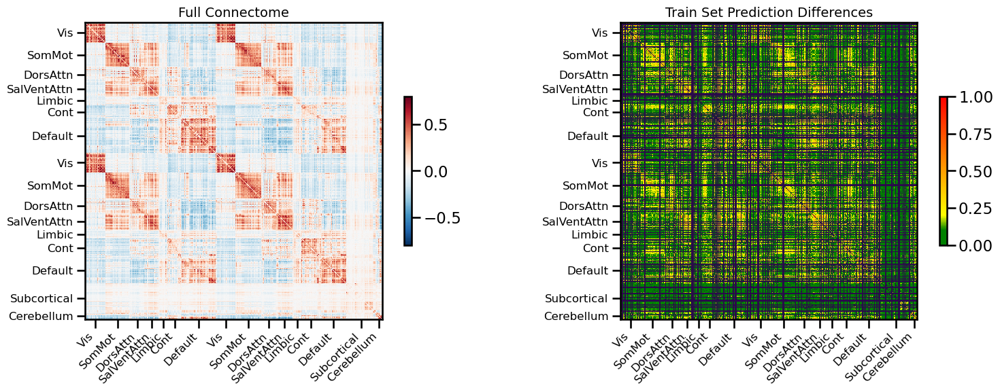

<Figure size 640x480 with 0 Axes>

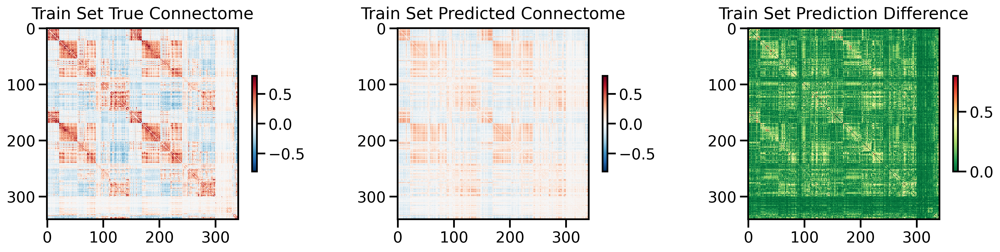

<Figure size 640x480 with 0 Axes>

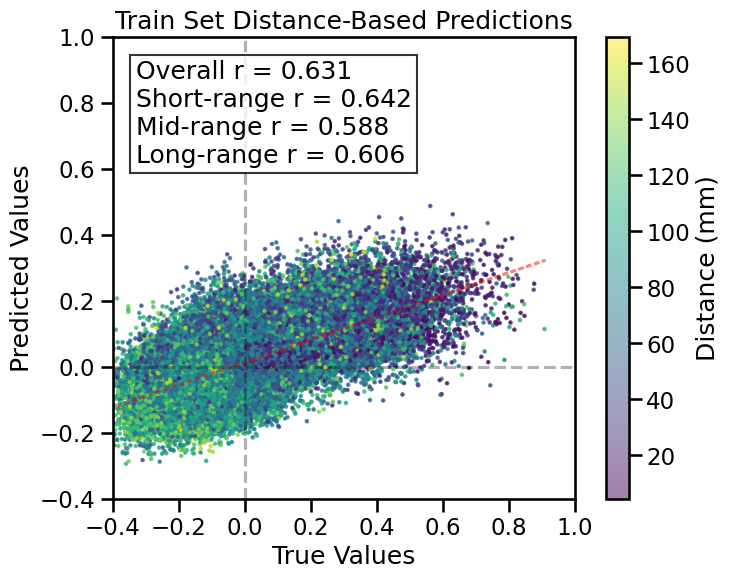

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 114 regions, 12882 connections


<Figure size 640x480 with 0 Axes>

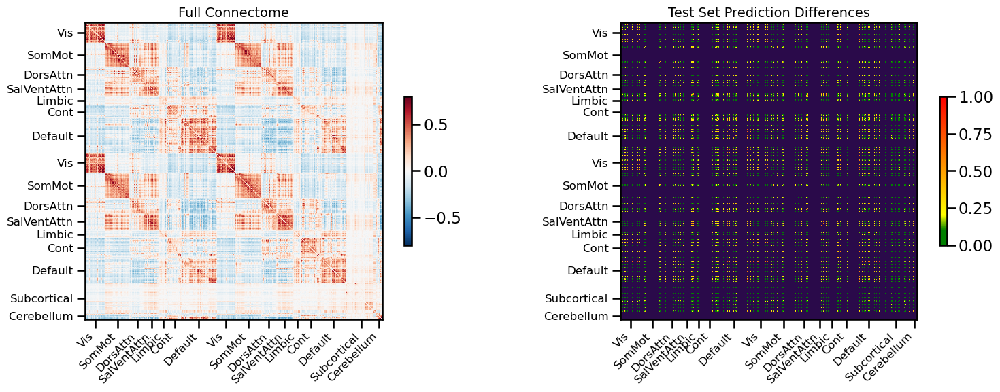

<Figure size 640x480 with 0 Axes>

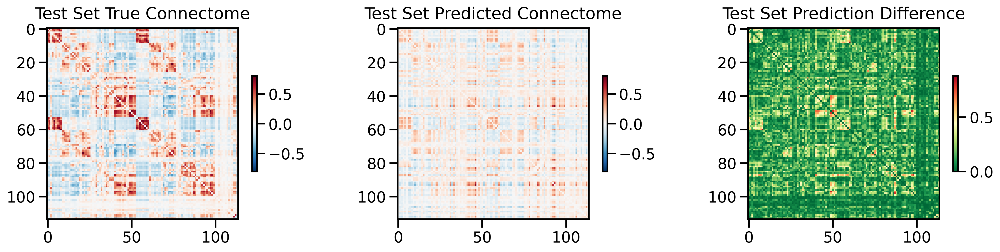

<Figure size 640x480 with 0 Axes>

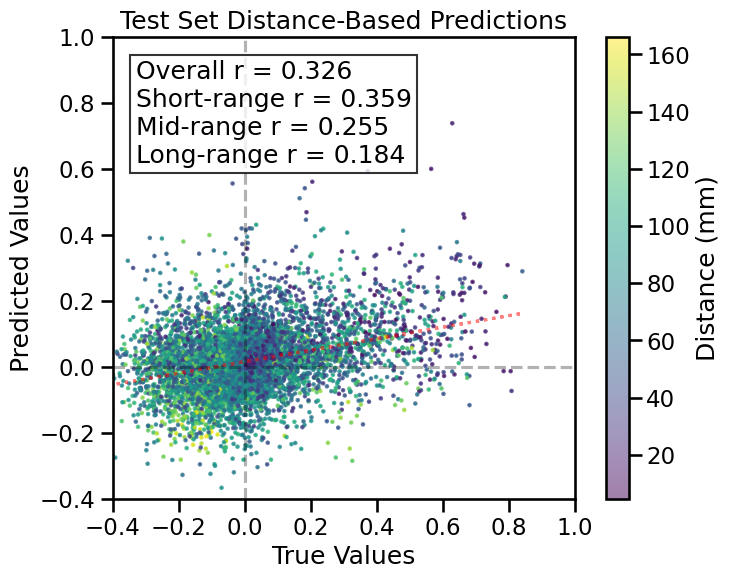

TRAIN METRICS
GLOBAL: mse=0.020341, mae=0.105740, r2=0.3895, pearson_r=0.6310, spearman_r=0.5915, geodesic_distance=27.4308
DISTANCE-BASED: short=0.6423, mid=0.5885, long=0.6057
HEMISPHERIC: left=0.6798, right=0.6123, inter=0.6169
CONNECTION STRENGTH: neg=0.0639, weak=0.5144, pos=0.2561
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.6822    0.6604
  Default       0.5161    0.6342
  SalVentAttn    0.6928    0.6817
  Limbic        0.6245    0.6503
  DorsAttn      0.7650    0.6905
  SomMot        0.7096    0.6838
  Vis           0.6453    0.6565
  Subcortical    0.3109    0.6414
  Cerebellum    0.5865    0.6267

TEST METRICS
GLOBAL: mse=0.033788, mae=0.136722, r2=0.0620, pearson_r=0.3255, spearman_r=0.2991, geodesic_distance=16.8575
DISTANCE-BASED: short=0.3594, mid=0.2546, long=0.1845
HEMISPHERIC: left=0.3124, right=0.3522, inter=0.3228
CONNECTION STRENGTH: neg=0.0271, weak=0.2184, pos=0.2216
NETWORK CORRELATIONS:
  NETWORK      I

0

<Figure size 640x480 with 0 Axes>

In [10]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              omit_subcortical=False,
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 5),
              track_wandb=False,
              skip_cv=True,
              model_type='bilinear_lowrank',
              use_gpu=True, 
              null_model='spin', 
              use_folds=[1])

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

### Multilayer Perceptron (MLP)

Resorting genes by reference genome order
Resorting genes by reference genome order
Number of components for 95% variance PCA: 27
Resorting genes by reference genome order
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
X_pca_full shape: (455, 455)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: ou3rzbsh
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/ou3rzbsh
Initialized sweep with ID: ou3rzbsh


  warnings.warn(



1
3
4
BEST CONFIG {'input_dim': 14760, 'hidden_dims': [512, 256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.1, 'weight_decay': 0.0001, 'epochs': 125}
Number of learnable parameters in MLP: 7723777
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.04 GB
Best val loss so far at epoch 1: 0.2716
Best val loss so far at epoch 2: 0.0254
Best val loss so far at epoch 3: 0.0227
Best val loss so far at epoch 4: 0.0213
Best val loss so far at epoch 5: 0.0186
Epoch 5/125, Train Loss: 0.0339, Val Loss: 0.0186, Time: 3.81s
Best val loss so far at epoch 8: 0.0171
Best val loss so far at epoch 10: 0.0152
Epoch 10/125, Train Loss: 0.0138, Val Loss: 0.0152, Time: 3.91s
Epoch 15/125, Train Loss: 0.0076, Val Loss: 0.0212, Time: 3.69s
Epoch 20/125, Train Loss: 0.0057, Val Loss: 0.0185, Time: 3.75s
Best val loss so far at epoch 21: 0.0150
Best val loss so far at epoch 22: 0.0146
Best val loss so far at epoch 23: 0.0137
Epoch 25/125, Train Loss: 0.0046, Val Loss: 

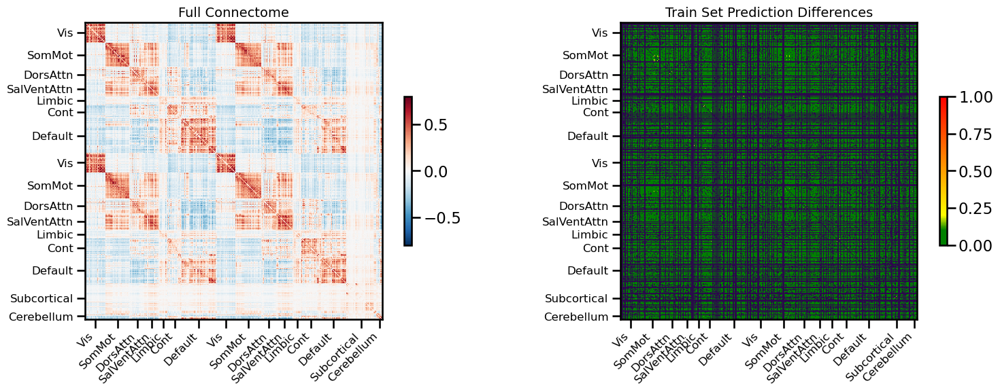

<Figure size 640x480 with 0 Axes>

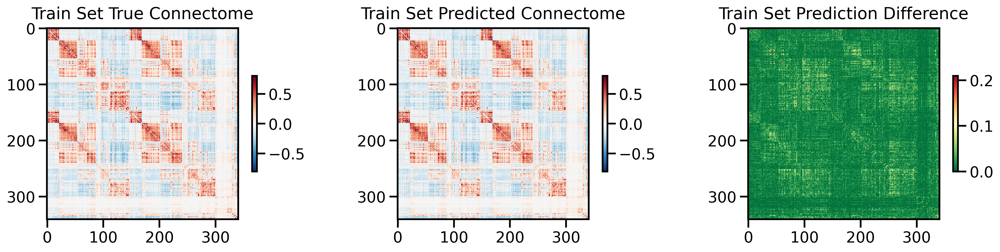

<Figure size 640x480 with 0 Axes>

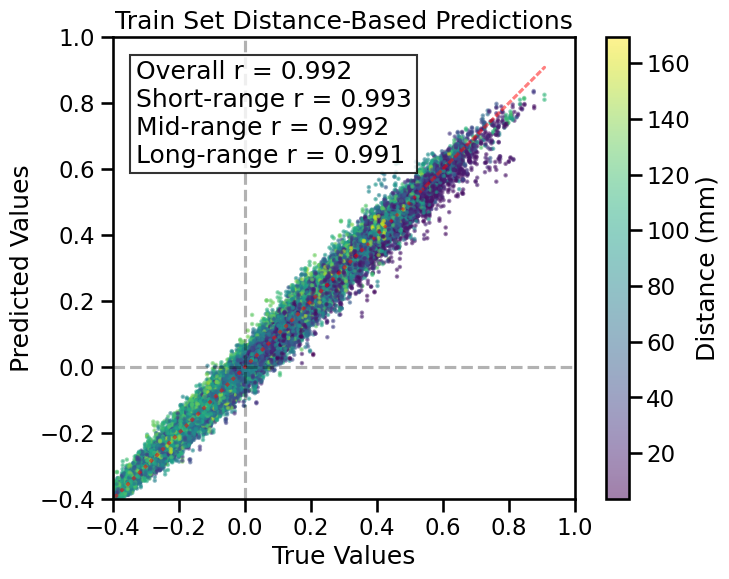

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 114 regions, 12882 connections


<Figure size 640x480 with 0 Axes>

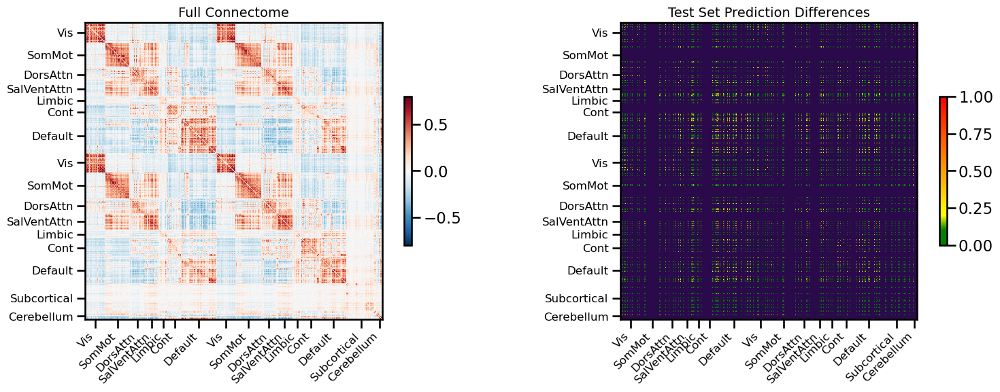

<Figure size 640x480 with 0 Axes>

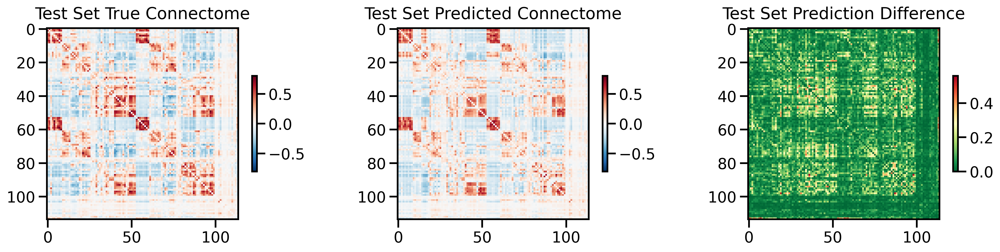

<Figure size 640x480 with 0 Axes>

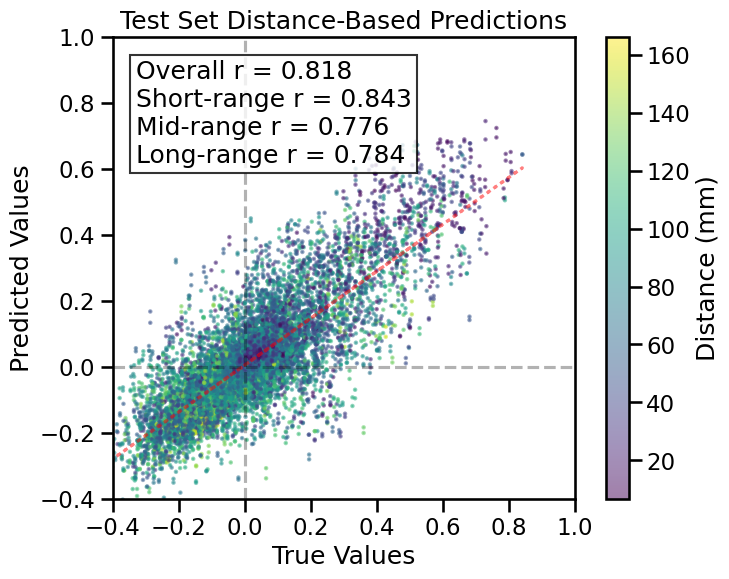

TRAIN METRICS
GLOBAL: mse=0.000506, mae=0.016330, r2=0.9848, pearson_r=0.9925, spearman_r=0.9904, geodesic_distance=12.7524
DISTANCE-BASED: short=0.9929, mid=0.9921, long=0.9906
HEMISPHERIC: left=0.9919, right=0.9939, inter=0.9933
CONNECTION STRENGTH: neg=0.8563, weak=0.9869, pos=0.9428
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9933    0.9925
  Default       0.9899    0.9924
  SalVentAttn    0.9951    0.9917
  Limbic        0.9869    0.9921
  DorsAttn      0.9959    0.9939
  SomMot        0.9943    0.9943
  Vis           0.9919    0.9930
  Subcortical    0.9902    0.9919
  Cerebellum    0.9653    0.9920

TEST METRICS
GLOBAL: mse=0.011666, mae=0.075407, r2=0.6671, pearson_r=0.8184, spearman_r=0.7795, geodesic_distance=10.0107
DISTANCE-BASED: short=0.8430, mid=0.7761, long=0.7837
HEMISPHERIC: left=0.7943, right=0.8748, inter=0.8048
CONNECTION STRENGTH: neg=0.1247, weak=0.6963, pos=0.5481
NETWORK CORRELATIONS:
  NETWORK      I

0

<Figure size 640x480 with 0 Axes>

In [11]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              omit_subcortical=False,
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 5),
              track_wandb=False,
              skip_cv=True,
              model_type='dynamic_mlp',
              use_gpu=True, 
              null_model='none', 
              use_folds=[1])

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

Resorting genes by reference genome order
Spinning gene expression
Spin index for seed 42: 9
Mean error rank for spin index 9: 263.3333333333333
Resorting genes by reference genome order
Number of components for 95% variance PCA: 27
Spinning gene expression
Spin index for seed 42: 9
Mean error rank for spin index 9: 263.3333333333333
Resorting genes by reference genome order
Spinning gene expression
Spin index for seed 42: 9
Mean error rank for spin index 9: 263.3333333333333
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
X_pca_full shape: (455, 455)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairw

wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: ye0h97o5
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/ye0h97o5
Initialized sweep with ID: ye0h97o5


  warnings.warn(



1
3
4
BEST CONFIG {'input_dim': 14760, 'hidden_dims': [512, 256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.1, 'weight_decay': 0.0001, 'epochs': 125}
Number of learnable parameters in MLP: 7723777
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.06 GB
Best val loss so far at epoch 1: 0.1386
Best val loss so far at epoch 2: 0.0351
Best val loss so far at epoch 3: 0.0338
Best val loss so far at epoch 5: 0.0327
Epoch 5/125, Train Loss: 0.0437, Val Loss: 0.0327, Time: 4.42s
Epoch 10/125, Train Loss: 0.0228, Val Loss: 0.0419, Time: 3.66s
Epoch 15/125, Train Loss: 0.0142, Val Loss: 0.0476, Time: 3.88s
Epoch 20/125, Train Loss: 0.0102, Val Loss: 0.0546, Time: 3.63s
Epoch 25/125, Train Loss: 0.0080, Val Loss: 0.0550, Time: 3.84s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.049575
Epoch 30/125, Train Loss: 0.0057, Val Loss: 0.0490, Time: 3.88s
Epoch 35/125, Train Loss: 0.0052, Val Loss: 0.0492, Time: 3.77s
Epoch 40/125, Train Loss: 0.0048, Val Los

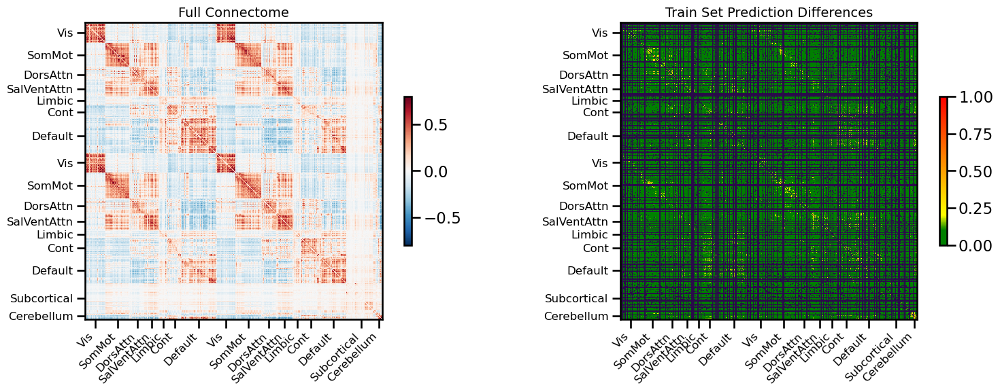

<Figure size 640x480 with 0 Axes>

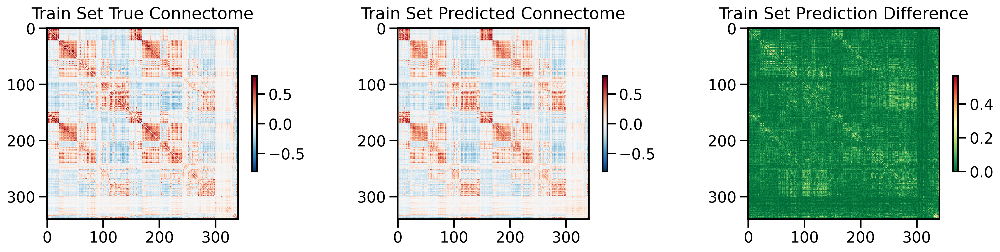

<Figure size 640x480 with 0 Axes>

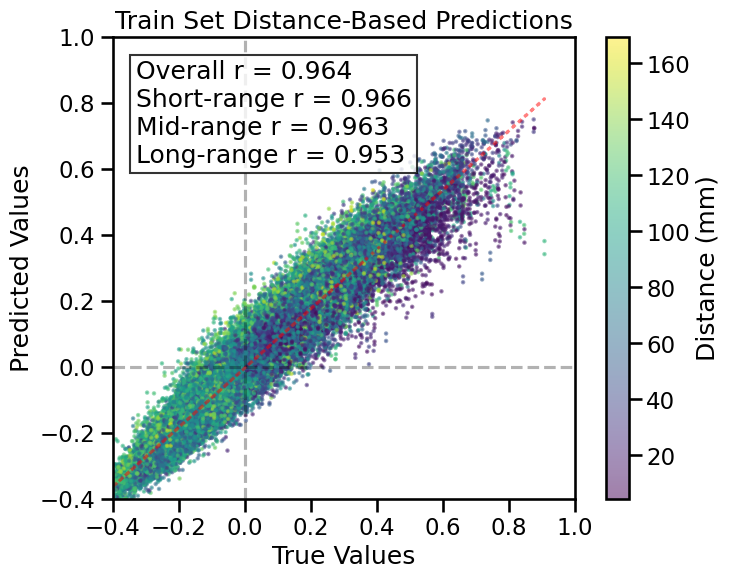

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 114 regions, 12882 connections


<Figure size 640x480 with 0 Axes>

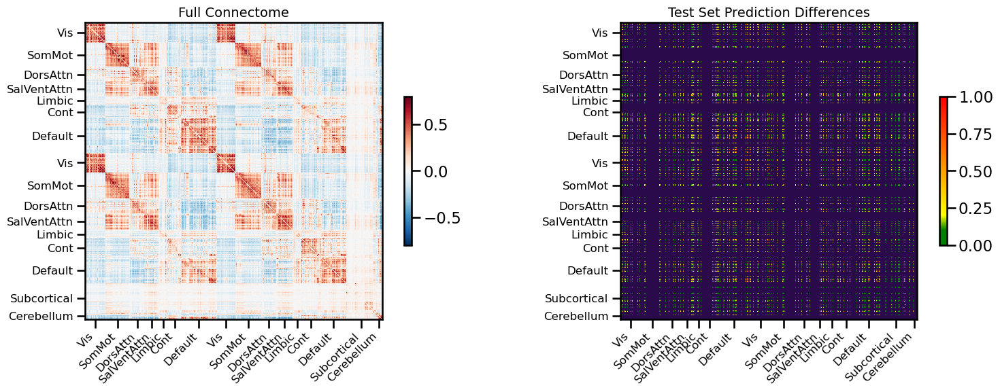

<Figure size 640x480 with 0 Axes>

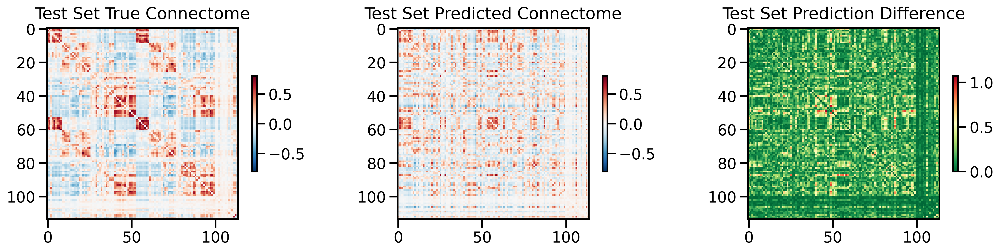

<Figure size 640x480 with 0 Axes>

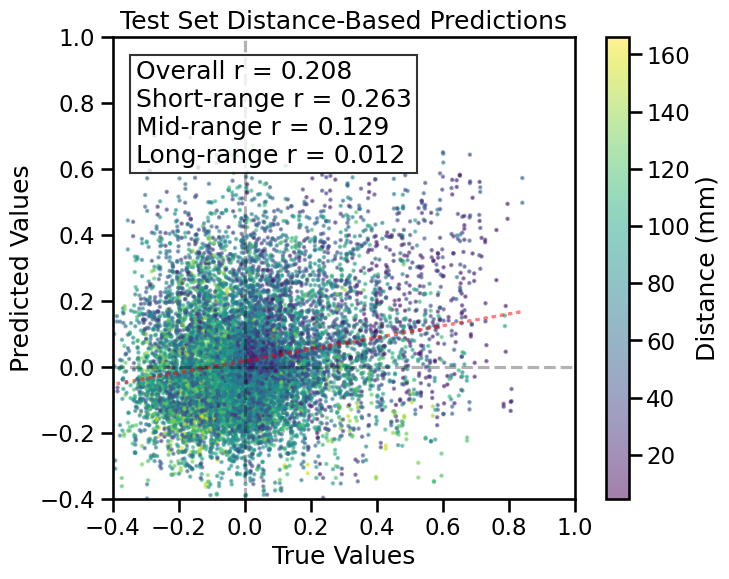

TRAIN METRICS
GLOBAL: mse=0.002412, mae=0.035092, r2=0.9276, pearson_r=0.9640, spearman_r=0.9587, geodesic_distance=16.6254
DISTANCE-BASED: short=0.9662, mid=0.9631, long=0.9527
HEMISPHERIC: left=0.9671, right=0.9673, inter=0.9625
CONNECTION STRENGTH: neg=0.6472, weak=0.9413, pos=0.7443
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9727    0.9712
  Default       0.9557    0.9692
  SalVentAttn    0.9837    0.9686
  Limbic        0.9659    0.9680
  DorsAttn      0.9815    0.9724
  SomMot        0.9751    0.9742
  Vis           0.9614    0.9677
  Subcortical    0.9698    0.9675
  Cerebellum    0.8769    0.9637

TEST METRICS
GLOBAL: mse=0.049683, mae=0.165383, r2=-0.3793, pearson_r=0.2075, spearman_r=0.1763, geodesic_distance=15.5438
DISTANCE-BASED: short=0.2626, mid=0.1293, long=0.0122
HEMISPHERIC: left=0.1904, right=0.2122, inter=0.2192
CONNECTION STRENGTH: neg=0.0264, weak=0.1010, pos=0.1473
NETWORK CORRELATIONS:
  NETWORK      

0

<Figure size 640x480 with 0 Axes>

In [11]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              omit_subcortical=False,
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 5),
              track_wandb=False,
              skip_cv=True,
              model_type='dynamic_mlp',
              use_gpu=True, 
              null_model='spin', 
              use_folds=[1])

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

**SMT w/ [CLS]**

In [8]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              omit_subcortical=False,
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 5),
              track_wandb=False,
              skip_cv=True,
              model_type='shared_transformer_cls',
              use_gpu=True, 
              null_model='none', 
              use_folds=[1])

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

Resorting genes by reference genome order
Resorting genes by reference genome order
Number of components for 95% variance PCA: 27
Resorting genes by reference genome order
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
X_pca_full shape: (455, 455)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


  return LooseVersion(v) >= LooseVersion(check)

ERROR: Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Using wandb-core as the SDK backend. Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: asratzan (alexander-ratzan-new-york-university). Use `wandb login --relogin` to force relogin
wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: rauvu7c8
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/rauvu7c8
Initialized sweep with ID: rauvu7c8
1
3
4
BEST CONFIG {'input_dim': 14760, 'token_encoder_dim': 20, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [512, 256, 128], 'cls_init': 'spatial_learned', 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 0.0001, 'weight_decay': 0.0001, 'batch_size': 1024, 'aug_prob': 0.3, 'aug_style': 'curriculum_swap_linear_decay', 'epochs': 110, 'num_workers': 2, 'prefetch_factor': 4}


  warnings.warn(



Number of learnable parameters in SMT w/ CLS model: 4686987
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.02 GB
Best val loss so far at epoch 1: 0.0524
Best val loss so far at epoch 2: 0.0377
Best val loss so far at epoch 3: 0.0346
Best val loss so far at epoch 4: 0.0321
Best val loss so far at epoch 5: 0.0286
Epoch 5/110, Train Loss: 0.1090, Val Loss: 0.0286, Time: 10.47s


LLVM ERROR: pthread_join failed: Invalid argument
LLVM ERROR: pthread_join failed: Invalid argument


RuntimeError: DataLoader worker (pid(s) 4008807) exited unexpectedly

Resorting genes by reference genome order
Spinning gene expression
Spin index for seed 42: 9
Mean error rank for spin index 9: 263.3333333333333
Resorting genes by reference genome order
Number of components for 95% variance PCA: 27
Spinning gene expression
Spin index for seed 42: 9
Mean error rank for spin index 9: 263.3333333333333
Resorting genes by reference genome order
Spinning gene expression
Spin index for seed 42: 9
Mean error rank for spin index 9: 263.3333333333333
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
X_pca_full shape: (455, 455)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairw

wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 00z0u3w9
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/00z0u3w9
Initialized sweep with ID: 00z0u3w9


  warnings.warn(



1
3
4
BEST CONFIG {'input_dim': 14760, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [256, 128], 'cls_init': 'spatial_learned', 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 0.0001, 'weight_decay': 0.0001, 'batch_size': 1024, 'aug_prob': 0.3, 'aug_style': 'curriculum_swap_linear_decay', 'epochs': 50, 'num_workers': 2, 'prefetch_factor': 4}
Number of learnable parameters in SMT w/ CLS model: 1405579
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.07 GB
Best val loss so far at epoch 1: 0.0481
Best val loss so far at epoch 2: 0.0385
Best val loss so far at epoch 3: 0.0380
Best val loss so far at epoch 4: 0.0357
Best val loss so far at epoch 5: 0.0345
Epoch 5/50, Train Loss: 0.1066, Val Loss: 0.0345, Time: 6.88s
Best val loss so far at epoch 6: 0.0333
Best val loss so far at epoch 8: 0.0324
Best val loss so far at epoch 9: 0.0308
Epoch 10/50, Train Loss: 0.0700

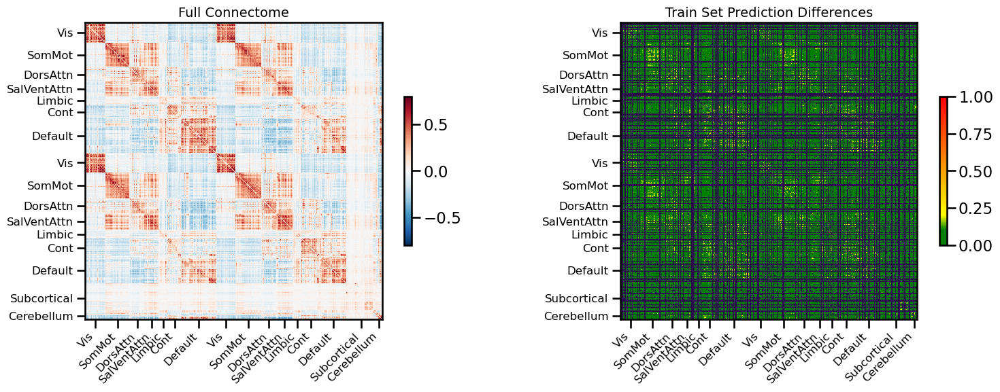

<Figure size 640x480 with 0 Axes>

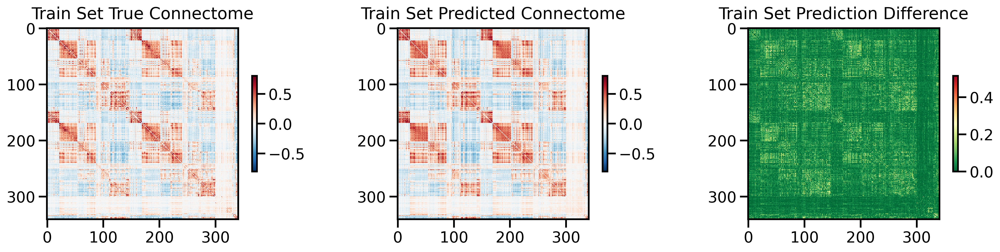

<Figure size 640x480 with 0 Axes>

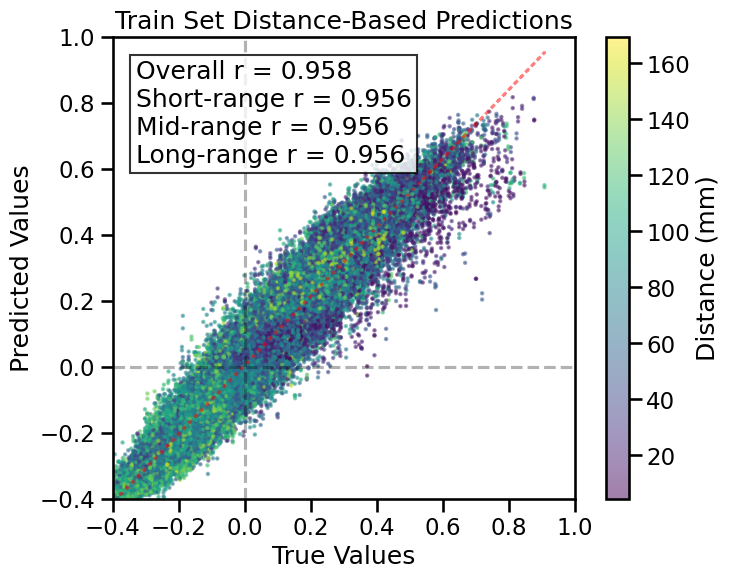

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 114 regions, 12882 connections


<Figure size 640x480 with 0 Axes>

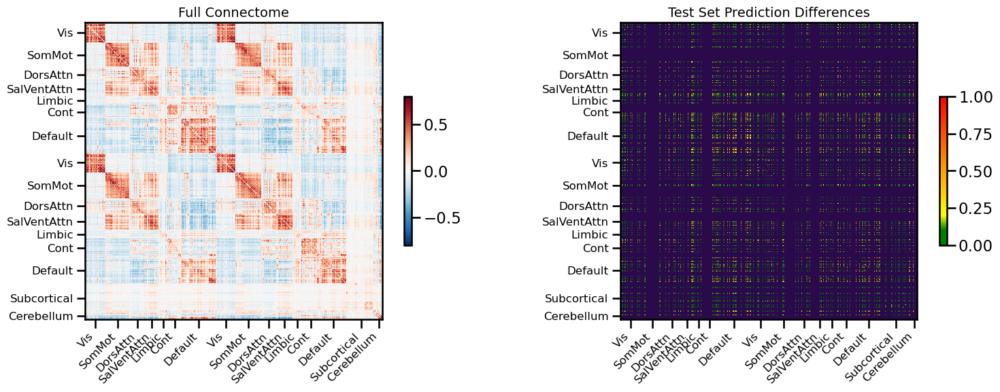

<Figure size 640x480 with 0 Axes>

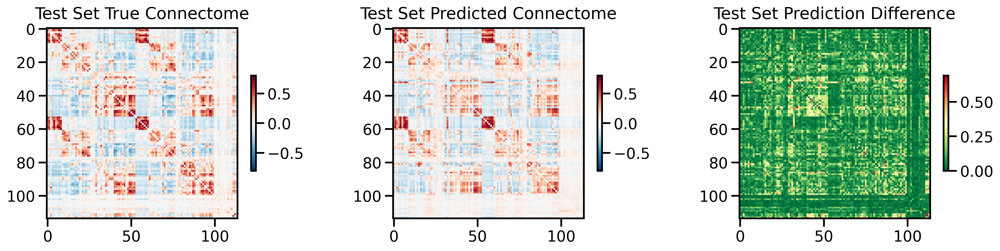

<Figure size 640x480 with 0 Axes>

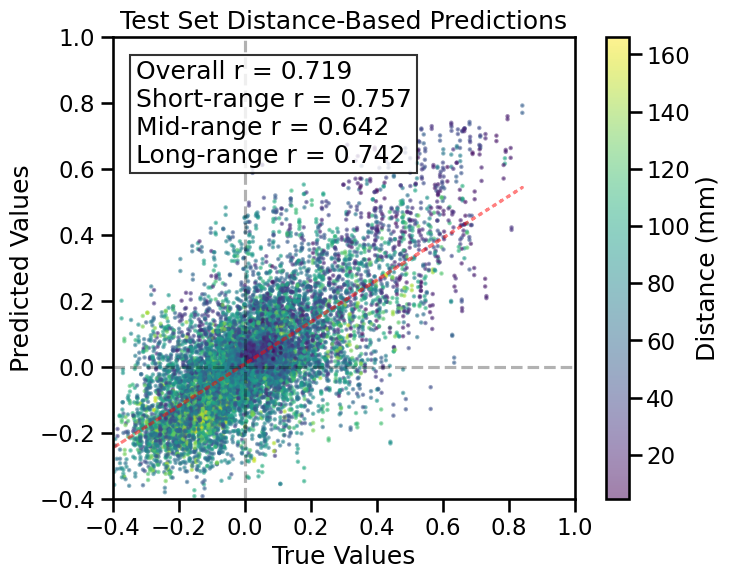

TRAIN METRICS
GLOBAL: mse=0.003333, mae=0.042700, r2=0.9000, pearson_r=0.9583, spearman_r=0.9527, geodesic_distance=15.6053
DISTANCE-BASED: short=0.9564, mid=0.9560, long=0.9555
HEMISPHERIC: left=0.9566, right=0.9606, inter=0.9586
CONNECTION STRENGTH: neg=0.5917, weak=0.9335, pos=0.6845
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9721    0.9637
  Default       0.9507    0.9610
  SalVentAttn    0.9713    0.9580
  Limbic        0.9548    0.9612
  DorsAttn      0.9725    0.9600
  SomMot        0.9652    0.9686
  Vis           0.9554    0.9579
  Subcortical    0.9609    0.9601
  Cerebellum    0.8872    0.9636

TEST METRICS
GLOBAL: mse=0.018380, mae=0.096721, r2=0.4897, pearson_r=0.7192, spearman_r=0.6657, geodesic_distance=11.4567
DISTANCE-BASED: short=0.7569, mid=0.6423, long=0.7417
HEMISPHERIC: left=0.6861, right=0.7540, inter=0.7318
CONNECTION STRENGTH: neg=0.4156, weak=0.5715, pos=0.5320
NETWORK CORRELATIONS:
  NETWORK      I

8075

<Figure size 640x480 with 0 Axes>

In [ ]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              omit_subcortical=False,
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 5),
              track_wandb=False,
              skip_cv=True,
              model_type='shared_transformer_cls',
              use_gpu=True, 
              null_model='spin', 
              use_folds=[1])

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()